In [1]:
import cv2
import os
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import LightSource
from matplotlib import cbook, cm
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
%matplotlib inline
import cv2
import numpy as np
from IPython.display import HTML, Video, display
from google.colab.patches import cv2_imshow

In [2]:
image = cv2.imread('data/image.jpg')
print(image)

# Show R,G,B channels
b, g, r = cv2.split(image)

fig, axs = plt.subplots(1, 3, figsize=(18, 6))
plt.set_cmap('gray')
plt.setp(plt.gcf().get_axes(), xticks=[], yticks=[])

axs[0].imshow(r)
axs[0].set_title('Red Channel')
axs[1].imshow(g)
axs[1].set_title('Green Channel')
axs[2].imshow(b)
axs[2].set_title('Blue Channel')
plt.show()


None


ValueError: not enough values to unpack (expected 3, got 0)

RGB Image Shape: (854, 1280, 3)
Grayscale Image Shape: (854, 1280)

[[107 108 109 ...  39  39  38]
 [112 113 114 ...  70  67  64]
 [117 118 120 ... 174 168 164]
 ...
 [184 183 182 ...  25  26  26]
 [184 183 182 ...  25  26  26]
 [184 183 182 ...  25  25  26]]


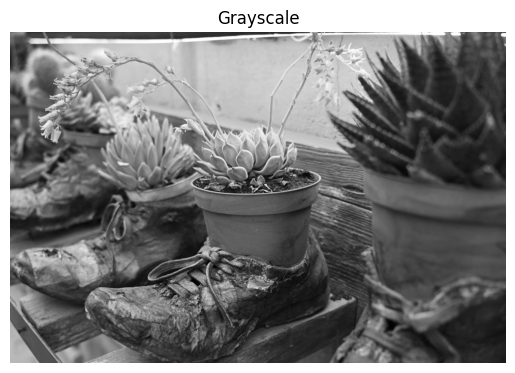

In [ ]:
# Convert to grayscale
print('RGB Image Shape:', image.shape)
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
print('Grayscale Image Shape:', gray.shape)
print()
print(gray)

plt.figure()
plt.imshow(gray)
plt.title('Grayscale')
plt.axis('off')
plt.show()

In [ ]:
# plot image as 2d heightmap
lowres = cv2.resize(gray, (gray.shape[1] // 2, gray.shape[0] // 2))
x = np.arange(0, lowres.shape[1])[::-1]
y = np.arange(0, lowres.shape[0])
x, y = np.meshgrid(x, y)

fig, ax = plt.subplots(subplot_kw=dict(projection='3d'))
surf = ax.plot_surface(x, y, lowres, cmap=cm.gray, linewidth=0, antialiased=False)
ax.set_box_aspect([lowres.shape[1], lowres.shape[0], 100])

def update_rotation(frame):
    factor = 0.5+0.5*np.cos(frame *2* np.pi / 100.0)
    ax.view_init(elev=45+factor*45, azim=90)

animation = FuncAnimation(fig, update_rotation, frames=np.arange(0, 360, 5), interval=100)
plt.close()
HTML(animation.to_jshtml())

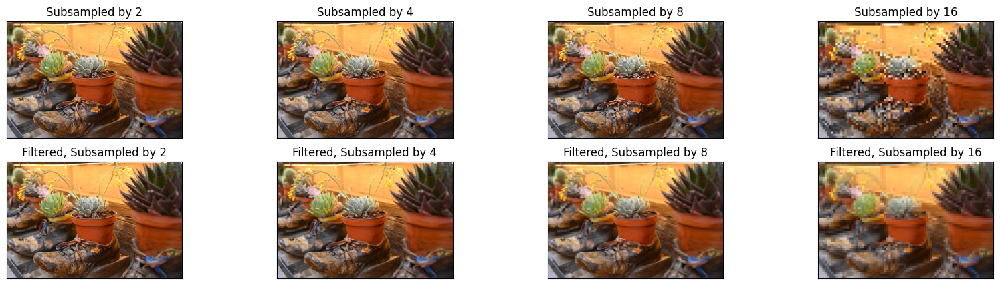

In [ ]:
# image subsampling
image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

fig, axs = plt.subplots(2, 4, figsize=(20, 5))
plt.setp(plt.gcf().get_axes(), xticks=[], yticks=[])

for i in range(1, 5):
    factor = 2**i
    low = image_rgb[::factor, ::factor]
    upsampled = cv2.resize(low, (image_rgb.shape[1], image_rgb.shape[0]), interpolation=cv2.INTER_NEAREST)
    axs[0, i-1].imshow(upsampled)
    axs[0, i-1].set_title(f'Subsampled by {factor}')

    filtered = cv2.blur(image_rgb, (factor, factor))
    low = filtered[::factor, ::factor]
    upsampled = cv2.resize(low, (image_rgb.shape[1], image_rgb.shape[0]), interpolation=cv2.INTER_NEAREST)
    axs[1, i-1].imshow(upsampled)
    axs[1, i-1].set_title(f'Filtered, Subsampled by {factor}')




---


# Point-wise transformations

In [ ]:
# create animations of image transformations
def create_video(filename, fps, shape):
    return cv2.VideoWriter(filename, cv2.VideoWriter_fourcc(*'mp4v'), fps, (shape[1], shape[0]))

def draw_text(img, text):
    cv2.putText(img, text, (10, img.shape[0]-10), cv2.FONT_HERSHEY_SIMPLEX, 3, (0, 0, 0), 5)
    cv2.putText(img, text, (10, img.shape[0]-10), cv2.FONT_HERSHEY_SIMPLEX, 3, (255, 255, 255), 3)

def show_video(filename, width=640):
    tmp_mp4 = f"{filename[:-4]}_H264{filename[-4:]}"
    os.system(f"ffmpeg -i {filename} -vcodec libx264 {tmp_mp4}")
    os.remove(filename)
    os.rename(tmp_mp4, filename)
    display(Video(filename, embed=True, width=width))

In [ ]:
# negative
filename = './02/transform_negative.mp4'
output = create_video(filename, 1, image.shape)
output.write(image)
output.write(255 - image)
output.release()
show_video(filename)


In [ ]:
# affine contrast
filename = '02/transform_affine_contrast.mp4'
output = create_video(filename, 30, image.shape)
for i in range(0,60):
    alpha = 1.0 + np.sin(2*np.pi*i/60.0)
    beta = 0
    img = np.clip(image*alpha + beta, 0, 255).astype(np.uint8)
    draw_text(img, f"a={alpha:.1f}, b={beta:.1f}")
    output.write(img)
for i in range(0,30):
    img = image.copy()
    draw_text(img, f"a=1.0, b=0.0")
    output.write(img)
for i in range(0,60):
    alpha = 1.0
    beta = np.sin(2*np.pi*i/60.0)*128
    img = np.clip(image*alpha + beta, 0, 255).astype(np.uint8)
    draw_text(img, f"a={alpha:.1f}")
    output.write(img)
for i in range(0,30):
    img = image.copy()
    draw_text(img, f"a=1.0, b=0.0")
    output.write(img)
output.release()
show_video(filename)


In [ ]:
# gamma
filename = '02/transform_gamma.mp4'
output = create_video(filename, 30, image.shape)
for i in range(0,120):
    gamma = 1.0 / (1.0 + 0.7*np.sin(2*np.pi*i/120.0))
    img = np.clip(image**gamma, 0, 255).astype(np.uint8)
    draw_text(img, f"gamma={gamma:.1f}")
    output.write(img)
output.release()
show_video(filename)

# Geometric transformations

In [ ]:
coordinate_frame = 255*np.ones((image.shape[0]*2, image.shape[1]*2, 3), dtype=np.uint8)
coordinate_frame[image.shape[0], :, :] = 0
coordinate_frame[:, image.shape[1], :] = 0

def draw_image_warped(M):
    img = coordinate_frame.copy()
    to_origin = np.float32([[1, 0, -image.shape[1]//2], [0, 1, -image.shape[0]//2], [0, 0, 1]])
    from_origin = np.float32([[1, 0, image.shape[1]//2], [0, 1, image.shape[0]//2], [0, 0, 1]])
    if isinstance(M, list):
        if len(M) == 2:
            M.append([0, 0, 1])
        M = np.float32(M)
    transform = from_origin @ from_origin @ M @ to_origin
    transform = transform[:2, :]
    img = cv2.warpAffine(image, transform, (coordinate_frame.shape[1], coordinate_frame.shape[0]), dst=img, borderMode=cv2.BORDER_TRANSPARENT)
    return img

In [ ]:
# translation
filename = '02/transform_translation.mp4'
output = create_video(filename, 30, coordinate_frame.shape)
for i in range(0,60):
    dx = 0.5*np.sin(2*np.pi*i/60.0)*image.shape[1]
    dy = 0
    img = draw_image_warped([[1, 0, dx], [0, 1, dy]])
    draw_text(img, f"dx={dx:.1f}, dy={dy:.1f}")
    output.write(img)
for i in range(0,60):
    dx = 0
    dy = 0.5*np.sin(2*np.pi*i/60.0)*image.shape[0]
    img = draw_image_warped([[1, 0, dx], [0, 1, dy]])
    draw_text(img, f"dx={dx:.1f}, dy={dy:.1f}")
    output.write(img)
output.release()
show_video(filename, width=1200)

In [ ]:
# scaling
filename = '02/transform_scaling.mp4'
output = create_video(filename, 30, coordinate_frame.shape)
for i in range(0,60):
    s = 1.00001+np.sin(2*np.pi*i/60.0)
    img = draw_image_warped([[s, 0, 0], [0, s, 0]])
    draw_text(img, f"s={s:.1f}")
    output.write(img)
output.release()
show_video(filename, width=1200)

In [ ]:
# rotation
filename = '02/transform_rotation.mp4'
output = create_video(filename, 30, coordinate_frame.shape)
for i in range(0,120):
    angle = 2*np.pi*i/120.0
    img = draw_image_warped([[np.cos(angle), -np.sin(angle), 0], [np.sin(angle), np.cos(angle), 0]])
    draw_text(img, f"angle={angle:.1f}")
    output.write(img)
output.release()
show_video(filename, width=1200)

In [ ]:
# horizontal shear
filename = '02/transform_h_shear.mp4'
output = create_video(filename, 30, coordinate_frame.shape)
for i in range(0,120):
    m = 1.0-np.cos(2*np.pi*i/120.0)
    img = draw_image_warped([[1, m, 0], [0, 1, 0]])
    draw_text(img, f"m={m:.1f}")
    output.write(img)
output.release()
show_video(filename, width=1200)

In [ ]:
# vertical shear
filename = '02/transform_v_shear.mp4'
output = create_video(filename, 30, coordinate_frame.shape)
for i in range(0,120):
    m = 1.0-np.cos(2*np.pi*i/120.0)
    img = draw_image_warped([[1, 0, 0], [m, 1, 0]])
    draw_text(img, f"m={m:.1f}")
    output.write(img)
output.release()
show_video(filename, width=1200)

In [ ]:
# chaining transformations
output_rt = create_video('02/transform_rottrans.mp4', 30, coordinate_frame.shape)
output_tr = create_video('02/transform_transrot.mp4', 30, coordinate_frame.shape)
for i in range(0,120):
    angle = 2*np.pi*i/120.0
    dx = 0.5*image.shape[1]
    dy = 0
    rot = np.float32([[np.cos(angle), -np.sin(angle), 0], [np.sin(angle), np.cos(angle), 0], [0, 0, 1]])
    trans = np.float32([[1, 0, dx], [0, 1, dy], [0, 0, 1]])
    img_rt = draw_image_warped(rot @ trans)
    draw_text(img_rt, f"angle={angle:.1f}, dx={dx:.1f}, dy={dy:.1f}")
    output_rt.write(img_rt)
    img_tr = draw_image_warped(trans @ rot)
    draw_text(img_tr, f"angle={angle:.1f}, dx={dx:.1f}, dy={dy:.1f}")
    output_tr.write(img_tr)
output_rt.release()
output_tr.release()
show_video('02/transform_rottrans.mp4')
show_video('02/transform_transrot.mp4')

# Image filtering

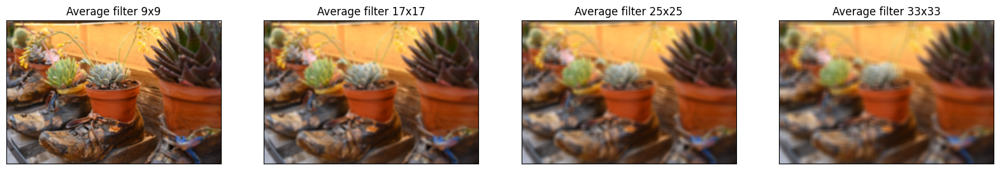

In [ ]:
# average filter
fig, axs = plt.subplots(1, 4, figsize=(20, 5))
plt.setp(plt.gcf().get_axes(), xticks=[], yticks=[])
for i in range(1,5):
    n = 8*i+1
    kernel = np.ones((n,n),np.float32)/(n**2)
    # cv2.imwrite(f"02/filtering_avg_{n}x{n}.jpg", cv2.filter2D(image,-1,kernel))
    filtered_image = cv2.filter2D(image,-1,kernel)
    axs[i-1].imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
    axs[i-1].set_title(f'Average filtering {n}x{n}')

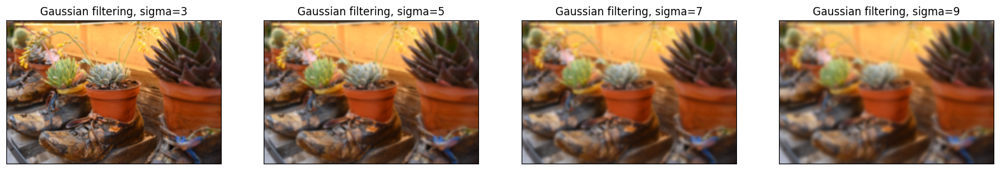

In [ ]:
# gaussian filter
fig, axs = plt.subplots(1, 4, figsize=(20, 5))
plt.setp(plt.gcf().get_axes(), xticks=[], yticks=[])
for i in range(1,5):
    sigma = 2*i+1
    filtered_image = cv2.GaussianBlur(image,(0,0),sigma)
    axs[i-1].imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
    axs[i-1].set_title(f'Gaussian filtering, sigma={sigma}')

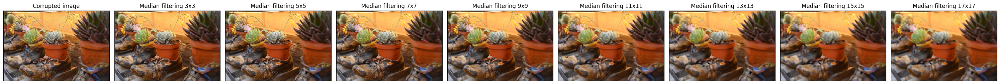

In [ ]:
# median filter
fig, axs = plt.subplots(1, 9, figsize=(30, 6))
plt.setp(plt.gcf().get_axes(), xticks=[], yticks=[])

salt_pepper = image.copy()
salt_pepper[np.random.randint(0, 255, size=(image.shape[0], image.shape[1], 3)) < 5] = 0
salt_pepper[np.random.randint(0, 255, size=(image.shape[0], image.shape[1], 3)) < 5] = 255
axs[0].imshow(cv2.cvtColor(salt_pepper, cv2.COLOR_BGR2RGB))
axs[0].set_title('Corrupted image')

for i in range(1,9):
    n = 2*i+1
    filtered_image = cv2.medianBlur(salt_pepper,n)
    axs[i].imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
    axs[i].set_title(f'Median filtering {n}x{n}')

plt.tight_layout()

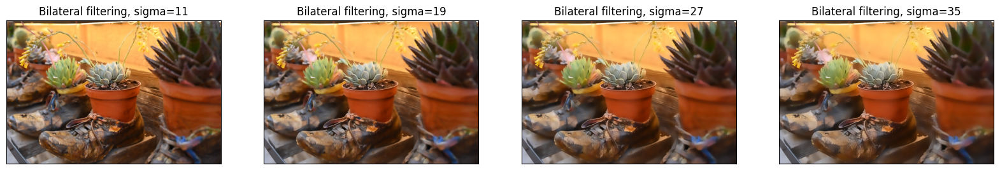

In [ ]:
# bilateral filter
fig, axs = plt.subplots(1, 4, figsize=(20, 5))
plt.setp(plt.gcf().get_axes(), xticks=[], yticks=[])

for i in range(0,5):
    sigma = 8*i+3
    cv2.imwrite(f"02/filtering_bilateral_{sigma}.jpg", cv2.bilateralFilter(image, sigma, 75, 75))
    filtered_image = cv2.bilateralFilter(image, sigma, 75, 75)
    axs[i-1].imshow(cv2.cvtColor(filtered_image, cv2.COLOR_BGR2RGB))
    axs[i-1].set_title(f'Bilateral filtering, sigma={sigma}')